In [1]:
import pandas as pd

df = pd.read_csv('dataset/leaf.csv', header=None)
df.head()

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15
0,1,1,0.72694,1.4742,0.32396,0.98535,1.00000,0.83592,0.004657,0.003947,0.047790,0.127950,0.016108,0.005232,0.000275,1.17560
1,1,2,0.74173,1.5257,0.36116,0.98152,0.99825,0.79867,0.005242,0.005002,0.024160,0.090476,0.008119,0.002708,0.000075,0.69659
2,1,3,0.76722,1.5725,0.38998,0.97755,1.00000,0.80812,0.007457,0.010121,0.011897,0.057445,0.003289,0.000921,0.000038,0.44348
3,1,4,0.73797,1.4597,0.35376,0.97566,1.00000,0.81697,0.006877,0.008607,0.015950,0.065491,0.004271,0.001154,0.000066,0.58785
4,1,5,0.82301,1.7707,0.44462,0.97698,1.00000,0.75493,0.007428,0.010042,0.007938,0.045339,0.002051,0.000560,0.000024,0.34214


In [2]:
df_label = 'class'
columns = {0: df_label, 8: 'max_indentation_depth',
           1: 'specimen_number', 9: 'lobedness',
           2: 'eccentricity', 10: 'avg_intensity',
           3: 'aspect_ratio', 11: 'avg_contrast',
           4: 'elongation', 12: 'smoothness',
           5: 'solidity', 13: 'third_moment',
           6: 'stochastic_convexity', 14: 'uniformity',
           7: 'isoperimetric_factor', 15: 'entropy'
           }
df = df.rename(columns=columns)
df.head()

,class,specimen_number,eccentricity,aspect_ratio,elongation,solidity,stochastic_convexity,isoperimetric_factor,max_indentation_depth,lobedness,avg_intensity,avg_contrast,smoothness,third_moment,uniformity,entropy
0,1,1,0.72694,1.4742,0.32396,0.98535,1.00000,0.83592,0.004657,0.003947,0.047790,0.127950,0.016108,0.005232,0.000275,1.17560
1,1,2,0.74173,1.5257,0.36116,0.98152,0.99825,0.79867,0.005242,0.005002,0.024160,0.090476,0.008119,0.002708,0.000075,0.69659
2,1,3,0.76722,1.5725,0.38998,0.97755,1.00000,0.80812,0.007457,0.010121,0.011897,0.057445,0.003289,0.000921,0.000038,0.44348
3,1,4,0.73797,1.4597,0.35376,0.97566,1.00000,0.81697,0.006877,0.008607,0.015950,0.065491,0.004271,0.001154,0.000066,0.58785
4,1,5,0.82301,1.7707,0.44462,0.97698,1.00000,0.75493,0.007428,0.010042,0.007938,0.045339,0.002051,0.000560,0.000024,0.34214


In [3]:
from pandas_profiling import ProfileReport

profile = ProfileReport(df)

In [4]:
profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

# Obserwacje
Główną cechą zbioru jest to, że jest bardzo dużo klas (30), ale mało próbek - zwykle około 10, średnio 11.3. Wszystkie wartości są ciągłe. Histogram dużej części cech przypomina ucięty przy wartości oczekiwanej rozkład normalny (eccentricity, aspect_ratio, solidity, max_indentation_depth, avg_intensity, smoothness, third_moment, uniformity). W większości pozostałych dominuje jeden przedział w histogramie. Isoperimetric_factor wygląda, jakby mógł być przybliżony miksturą rozkładów normalnych.
Widać wyraźną korelacje pomiędzy cechami związanymi z kształtem, a także pomiędzy cechami związanymi z powierzchnią.


In [5]:
df = df.drop(columns=['specimen_number'])  # nr okazu

In [6]:
from sklearn.model_selection import train_test_split

df_label = 'class'
df_x, df_y = df.drop(columns=[df_label]), df[df_label]
df_x_train, df_x_test, df_y_train, df_y_test = train_test_split(df_x, df_y, stratify=df_y, test_size=0.2)

In [7]:
from sklearn.naive_bayes import GaussianNB

clf = GaussianNB()
clf.fit(df_x_train, df_y_train)
clf.score(df_x_test, df_y_test)

0.7647058823529411

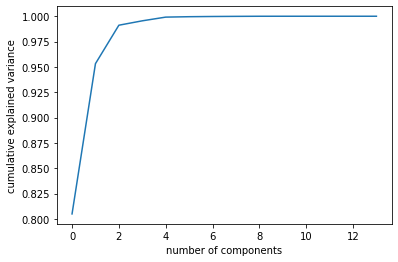

In [8]:
import numpy as np
from matplotlib import pyplot as plt
from sklearn.decomposition import PCA

pca = PCA(n_components=14)
pca.fit_transform(df_x_train)
plt.plot(np.cumsum(pca.explained_variance_ratio_))
plt.xlabel('number of components')
plt.ylabel('cumulative explained variance');
#  wyraźnie widać, że większość informacji zawarta w 1. komponencie, od 4 właściwie nie ma jej wcale

In [9]:
pca = PCA(n_components=3)
x_train_transformed = pca.fit_transform(df_x_train)
x_test_transformed = pca.transform(df_x_test)
clf = GaussianNB()
clf.fit(x_train_transformed, df_y_train)
clf.score(x_test_transformed, df_y_test)

0.5735294117647058

# Pair gridy
Sprawdzono, czy da się zwizualizować prostą zależność między parami cech, również po redukcji wymiarów. Wykresy nie pokazują czegoś takiego.

In [10]:
import seaborn as sb

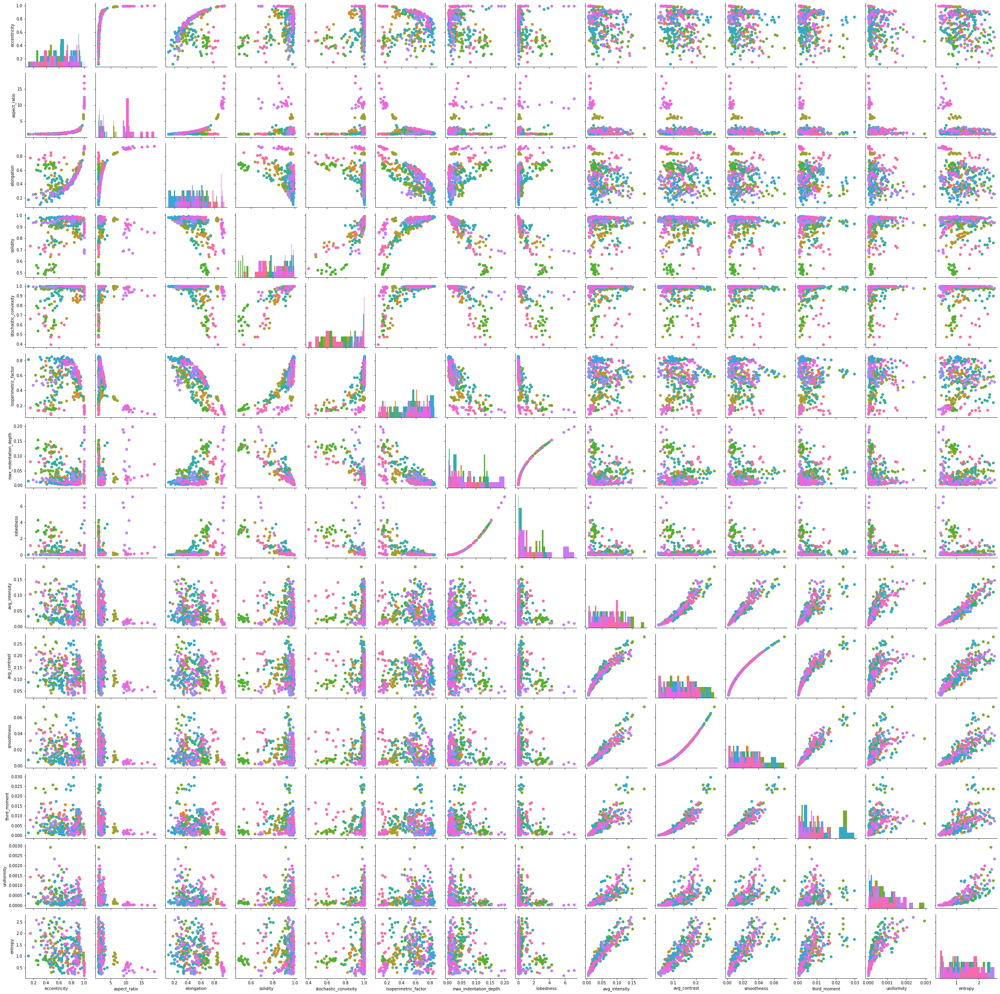

In [11]:
g = sb.PairGrid(df, hue=df_label)
g.map_diag(plt.hist)
g.map_offdiag(plt.scatter)
plt.show()

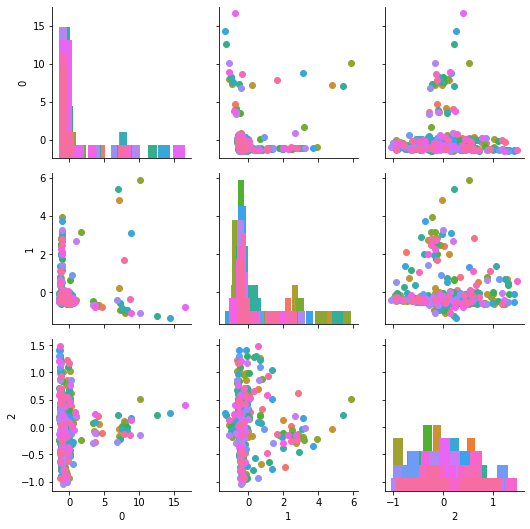

In [12]:
df_transformed = pd.DataFrame(np.concatenate([x_train_transformed, x_test_transformed]))
df_transformed[df_label] = pd.concat([df_y_train, df_y_test])
g = sb.PairGrid(df_transformed, hue=df_label)
g.map_diag(plt.hist)
g.map_offdiag(plt.scatter)
plt.show()

# Podsumowanie
Analiza pokazuje, że dane są kompletne i pozwalają na predykcję, którą wstępnie sprawdzono. Zauważono, że cechy dzielą się na 3 główne, skorelowane ze sobą grupy, jednak nie ma oczywistych zależności, które pozwoliłyby klasyfikować elementy w sposób banalny. Często występujący w cechach rozkład normalny i dobra korelacja pozwala spodziewać się, że metody probabilistyczne będą działać całkiem dobrze, zwłaszcza,że są w porównaniu z innymi metodami dość odporne na małą liczbę próbek. Wstępne, proste sprawdzenie naiwnego bayesa również nie przeczy tym założeniom.